In [44]:
# import libraries
from tensorflow import keras
import numpy as np
import os
import time
import datetime
import h5py
import random
from scipy import spatial
import cv2
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
# define the data location and load data
cwd = os.getcwd()
pardir = os.path.dirname(cwd)
data_folder = os.path.join(pardir,"data")
output_folder = os.path.join(pardir, "results", "video_pred_quan_eval_results")
data_path = os.path.join(data_folder, "dataset_all",'video_prediction_dataset.hdf5')

print("data_folder:", data_folder)
print("data_path:", data_path)

data_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/data
data_path: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/data/dataset_all/video_prediction_dataset.hdf5


In [3]:
# load testing data
times_test = np.load(os.path.join(data_folder,"dataset_all","times_curr_test.npy"),allow_pickle=True)
print("times_test.shape:", times_test.shape)

with h5py.File(data_path,'r') as f:

    # read in the data
    images_log_test = f['test']['images_log'][:,::2,:,:,:]
    images_pred_test = f['test']['images_pred'][:,::2,:,:,:]

print("images_log_test.shape:",images_log_test.shape)
print("images_pred_test.shape:",images_pred_test.shape)

times_test.shape: (4467,)
images_log_test.shape: (4467, 8, 64, 64, 3)
images_pred_test.shape: (4467, 8, 64, 64, 3)


In [4]:
random.seed(0)
select_num_samples = 30
select_idx = random.sample(np.arange(len(times_test)).tolist(),select_num_samples)
select_idx

[3155,
 3445,
 331,
 2121,
 4188,
 3980,
 3317,
 2484,
 3904,
 2933,
 1789,
 4134,
 1140,
 2308,
 1144,
 776,
 2052,
 4362,
 1203,
 2540,
 809,
 604,
 2704,
 3867,
 824,
 2898,
 3556,
 2590,
 1675,
 3907]

In [5]:
# mask out img background
def mask_background(img): # put all background pixels to 0s
    mask_img = img.copy()
    for i in range(64):
        for j in range(64):
            if (i-30)**2+(j-30)**2>=31**2:
                mask_img[:,:,i,j,:]=0
    return mask_img

In [6]:
# mask out the background
mask_images_pred_test = mask_background(images_pred_test)
mask_images_pred_test = mask_images_pred_test.astype('float32')/255
print(mask_images_pred_test.shape)

(4467, 8, 64, 64, 3)


In [7]:
# calculate VGG cosine similarity
vgg16 = keras.applications.VGG16(weights='imagenet',include_top=True,pooling='max',input_shape=(224,224,3))
vgg16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [37]:
basemodel=keras.Model(inputs=vgg16.input,outputs=keras.layers.Flatten()(vgg16.get_layer('block4_pool').output))

In [9]:
def get_feature_vector(img):
    #img1= cv2.resize(img,(224,224))
    #evaluate in batch 
    feature_vector = np.zeros((img.shape[0],img.shape[1],basemodel.output.shape[-1]))
    #batch_size = 250
    num_samples = img.shape[0]
    #indices = np.arange(num_samples)
    #for i in range(int(num_samples / batch_size) + 1):
    for i in range(num_samples):
        #start_time = time.time()
        #start_idx = (i * batch_size) % num_samples
        #idxs = indices[start_idx:start_idx + batch_size]
        #feature_vector[idxs] = basemodel.predict(img[idxs])
        feature_vector[i] = basemodel.predict(img[i])
        #end_time = time.time()
        #print("batch {0} samples: {1} to {2}, {3:.2f}% finished, processing time {4:.2f}s"
        #  .format(i+1, idxs[0],idxs[-1],(idxs[-1]/num_samples)*100,(end_time-start_time)))
    return feature_vector

In [10]:
def get_feature_vector2(img):
    #img1= cv2.resize(img,(224,224))
    feature_vector = np.zeros((img.shape[0],img.shape[1],basemodel.output.shape[-1]))
    #evaluate in batch 
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            feature_vector[i,j] = basemodel.predict(img[i,j].reshape(1, 224, 224, 3))
    return feature_vector

In [11]:
def get_feature_vector3(img):
    #img1= cv2.resize(img,(224,224))
    #evaluate in batch 
    #feature_vector = np.zeros((img.shape[0],img.shape[1],basemodel.output.shape[-1]))
    img1 = img.reshape(-1,224,224,3)
    feature_vector = np.zeros((img1.shape[0],basemodel.output.shape[-1]))
    batch_size = 100
    num_samples = img1.shape[0]
    indices = np.arange(num_samples)
    for i in range(int(num_samples / batch_size) + 1):
    #for i in range(num_samples):
        #start_time = time.time()
        start_idx = (i * batch_size) % num_samples
        idxs = indices[start_idx:start_idx + batch_size]
        feature_vector[idxs] = basemodel.predict(img1[idxs])
        #feature_vector[i] = basemodel.predict(img[i])
        #end_time = time.time()
        #print("batch {0} samples: {1} to {2}, {3:.2f}% finished, processing time {4:.2f}s"
        #  .format(i+1, idxs[0],idxs[-1],(idxs[-1]/num_samples)*100,(end_time-start_time)))
    feature_vector=feature_vector.reshape((img.shape[0],img.shape[1],basemodel.output.shape[-1]))
    return feature_vector

In [17]:
start_time = time.time()
feature_vector_gt1 = get_feature_vector(mask_images_pred_test_resized[:1000])
end_time = time.time()
print(end_time-start_time)

45.94663071632385


In [18]:
start_time = time.time()
feature_vector_gt2 = get_feature_vector2(mask_images_pred_test_resized[:100])
end_time = time.time()
print(end_time-start_time)

26.322303533554077


In [16]:
start_time = time.time()
feature_vector_gt3 = get_feature_vector3(mask_images_pred_test_resized[:1000])
end_time = time.time()
print(end_time-start_time)

20.101186990737915


In [40]:
mask_images_pred_test_resized = np.zeros((images_pred_test.shape[0],images_pred_test.shape[1],224,224,3))
for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        mask_images_pred_test_resized[i,j] = cv2.resize(mask_images_pred_test[i,j],(224,224))
feature_vector_gt_test = get_feature_vector3(mask_images_pred_test_resized*255)

In [41]:
feature_vector_gt_test.shape

(4467, 8, 100352)

In [15]:
def calculate_cosine_similarity(vector1, vector2):
    cosine_similarity = 1-spatial.distance.cosine(vector1,vector2)
    return cosine_similarity

### Evaluation of model performance quantitatively

#### ConvLSTM

In [70]:
# video prediction models for predicted images
vp_model = "ConvLSTM"
vp_model_name = vp_model+'_sky_image_dataset_interval_2min_all_data_v2'
vp_model_folder = os.path.join(pardir,"models",vp_model,"save", vp_model_name)

print("vp_model_folder:", vp_model_folder)

# load predicted images
predicted_images = np.load(os.path.join(vp_model_folder,"predicted_images.npy"))
predicted_images = mask_background(predicted_images.astype('float32'))
predicted_images_resized = np.zeros((predicted_images.shape[0],predicted_images.shape[1],224,224,3))
for i in range(predicted_images.shape[0]):
    for j in range(predicted_images.shape[1]):
        predicted_images_resized[i,j] = cv2.resize(predicted_images[i,j],(224,224))
feature_vector_pred_test = get_feature_vector3(predicted_images_resized*255)
print("predicted_images.shape:",predicted_images.shape)
print("feature_vector_pred_test.shape:",feature_vector_pred_test.shape)

vp_model_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/models/ConvLSTM/save/ConvLSTM_sky_image_dataset_interval_2min_all_data_v2
predicted_images.shape: (4467, 8, 64, 64, 3)
feature_vector_pred_test.shape: (4467, 8, 100352)


0.6214238633936983


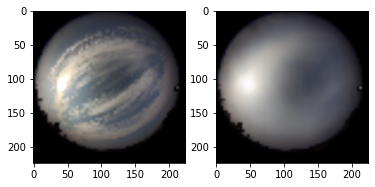

In [71]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[100,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[100,7][:,:,::-1])
f1 = feature_vector_gt_test[100,7]
f2 = feature_vector_pred_test[100,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.8559662774276123


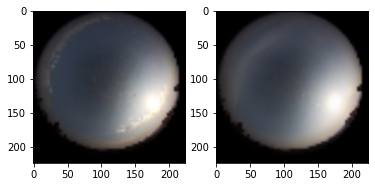

In [72]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[500,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[500,7][:,:,::-1])
f1 = feature_vector_gt_test[500,7]
f2 = feature_vector_pred_test[500,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.5619718019591382


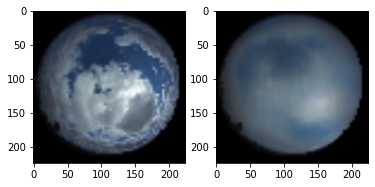

In [73]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[3445,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[3445,7][:,:,::-1])
f1 = feature_vector_gt_test[3445,7]
f2 = feature_vector_pred_test[3445,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.5865915889497997


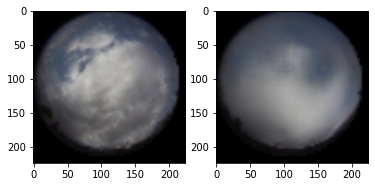

In [74]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[2484,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[2484,7][:,:,::-1])
f1 = feature_vector_gt_test[2484,7]
f2 = feature_vector_pred_test[2484,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

In [75]:
mse_per_frame = np.mean(np.sum((predicted_images-mask_images_pred_test)**2,axis=(2,3,4)),axis=0)
mae_per_frame = np.mean(np.sum(np.abs(predicted_images-mask_images_pred_test),axis=(2,3,4)),axis=0)
ssim_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))
cosine_similarity_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))

for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        ssim_per_frame[i,j] = ssim(mask_images_pred_test[i,j], predicted_images[i,j], multichannel=True)
        
        # calcuate vgg cosine similarity
        cosine_similarity_per_frame[i,j] = calculate_cosine_similarity(feature_vector_gt_test[i,j],feature_vector_pred_test[i,j])

ssim_per_frame = np.mean(ssim_per_frame, axis=0)
cosine_similarity_per_frame = np.mean(cosine_similarity_per_frame, axis=0)

#np.save(os.path.join(output_folder,'ConvLSTM_mse'),mse_per_frame)
#np.save(os.path.join(output_folder,'ConvLSTM_mae'),mae_per_frame)
#np.save(os.path.join(output_folder,'ConvLSTM_ssim'),ssim_per_frame)
np.save(os.path.join(output_folder,'ConvLSTM_cosine_similarity_block4_pool'),cosine_similarity_per_frame)   

for j in range(images_pred_test.shape[1]):
    print('-'*50)
    print('evaluation for {0} min'.format(j*2+1))
    print('mse (frame-wise): ', mse_per_frame[j])
    print('mae (frame-wise): ', mae_per_frame[j])
    print('ssim: ', ssim_per_frame[j])
    print('cosine_similarity: ', cosine_similarity_per_frame[j])

print("*"*50)
print('overall performance:')
print('mse (frame-wise): ', np.mean(mse_per_frame))
print('mae (frame-wise): ', np.mean(mae_per_frame))
print('ssim: ', np.mean(ssim_per_frame))
print('cosine_similarity: ', np.mean(cosine_similarity_per_frame))

--------------------------------------------------
evaluation for 1 min
mse (frame-wise):  26.563265
mae (frame-wise):  283.91394
ssim:  0.886085669468546
cosine_similarity:  0.8006570976611652
--------------------------------------------------
evaluation for 3 min
mse (frame-wise):  36.553524
mae (frame-wise):  350.2381
ssim:  0.8614169009182696
cosine_similarity:  0.7549114596677876
--------------------------------------------------
evaluation for 5 min
mse (frame-wise):  43.9933
mae (frame-wise):  393.8982
ssim:  0.8473908130324574
cosine_similarity:  0.7302192914300248
--------------------------------------------------
evaluation for 7 min
mse (frame-wise):  50.192677
mae (frame-wise):  427.33072
ssim:  0.8380170663706286
cosine_similarity:  0.7115363357004993
--------------------------------------------------
evaluation for 9 min
mse (frame-wise):  55.62477
mae (frame-wise):  454.9436
ssim:  0.8306897631451767
cosine_similarity:  0.6963864303583498
--------------------------------

In [21]:
def get_feature_vector(img):
    img1 = cv2.resize(img, (224, 224))
    feature_vector = basemodel.predict(img1.reshape(1, 224, 224, 3))
    return feature_vector

In [30]:
predicted_images.shape

(4467, 8, 64, 64, 3)

In [33]:
# extract feature after 'block3_pool' layer
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))
    #f,ax=plt.subplots(1,2)
    #ax[0].imshow(mask_images_pred_test[2484,i][:,:,::-1])
    #ax[1].imshow(predicted_images[2484,i][:,:,::-1])
    #plt.show()

0.6907038688659668
0.6079630851745605
0.5955344438552856
0.606594979763031
0.6100353598594666
0.5898922681808472
0.5518408417701721
0.5502210855484009


In [35]:
# extract feature after 'flatten' layer
basemodel=keras.Model(inputs=vgg16.input,outputs=keras.layers.Flatten()(vgg16.get_layer('flatten').output))
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))
    #f,ax=plt.subplots(1,2)
    #ax[0].imshow(mask_images_pred_test[2484,i][:,:,::-1])
    #ax[1].imshow(predicted_images[2484,i][:,:,::-1])
    #plt.show()

0.818848729133606
0.7670873403549194
0.7012437582015991
0.7012606263160706
0.6945331692695618
0.6564558148384094
0.676828920841217
0.693810760974884


In [36]:
# extract feature after 'block4_pool' layer
basemodel=keras.Model(inputs=vgg16.input,outputs=keras.layers.Flatten()(vgg16.get_layer('block4_pool').output))
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))
    #f,ax=plt.subplots(1,2)
    #ax[0].imshow(mask_images_pred_test[2484,i][:,:,::-1])
    #ax[1].imshow(predicted_images[2484,i][:,:,::-1])
    #plt.show()

0.7235325574874878
0.6608703136444092
0.6462249755859375
0.6367125511169434
0.6239951848983765
0.5960738658905029
0.5805130004882812
0.5865950584411621


In [ ]:
0.6941825151443481
0.6776711344718933
0.6389331817626953
0.6477095484733582
0.635533332824707
0.6118957996368408
0.6201027035713196
0.6151658296585083

#### PhyDNet

In [38]:
# video prediction models for predicted images
vp_model = "PhyDNet"
vp_model_name = vp_model+'_sky_image_dataset_interval_2min_all_data_v2'
vp_model_folder = os.path.join(pardir,"models",vp_model,"save", vp_model_name)

print("vp_model_folder:", vp_model_folder)

predicted_images = np.load(os.path.join(vp_model_folder,"predicted_images.npy"))
predicted_images = mask_background(predicted_images.astype('float32'))
predicted_images_resized = np.zeros((predicted_images.shape[0],predicted_images.shape[1],224,224,3))
for i in range(predicted_images.shape[0]):
    for j in range(predicted_images.shape[1]):
        predicted_images_resized[i,j] = cv2.resize(predicted_images[i,j],(224,224))
feature_vector_pred_test = get_feature_vector3(predicted_images_resized*255)
print("predicted_images.shape:",predicted_images.shape)
print("feature_vector_pred_test.shape:",feature_vector_pred_test.shape)

vp_model_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/models/PhyDNet/save/PhyDNet_sky_image_dataset_interval_2min_all_data_v2
predicted_images.shape: (4467, 8, 64, 64, 3)
feature_vector_pred_test.shape: (4467, 8, 100352)


0.5924692854227431


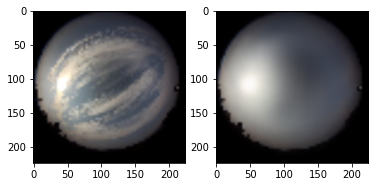

In [45]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[100,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[100,7][:,:,::-1])
f1 = feature_vector_gt_test[100,7]
f2 = feature_vector_pred_test[100,7]
print(calculate_cosine_similarity(f1,f2))
#plt.show()

0.8346440182969384


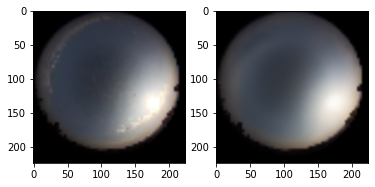

In [46]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[500,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[500,7][:,:,::-1])
f1 = feature_vector_gt_test[500,7]
f2 = feature_vector_pred_test[500,7]
print(calculate_cosine_similarity(f1,f2))
#plt.show()

0.5350852775882339


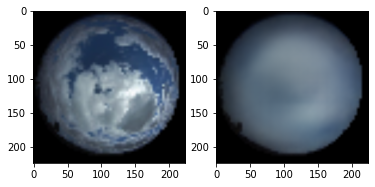

In [47]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[3445,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[3445,7][:,:,::-1])
f1 = feature_vector_gt_test[3445,7]
f2 = feature_vector_pred_test[3445,7]
print(calculate_cosine_similarity(f1,f2))
#plt.show()

In [48]:
mse_per_frame = np.mean(np.sum((predicted_images-mask_images_pred_test)**2,axis=(2,3,4)),axis=0)
mae_per_frame = np.mean(np.sum(np.abs(predicted_images-mask_images_pred_test),axis=(2,3,4)),axis=0)
ssim_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))
cosine_similarity_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))

for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        ssim_per_frame[i,j] = ssim(mask_images_pred_test[i,j], predicted_images[i,j], multichannel=True)
        
        # calcuate vgg cosine similarity
        cosine_similarity_per_frame[i,j] = calculate_cosine_similarity(feature_vector_gt_test[i,j],feature_vector_pred_test[i,j])

ssim_per_frame = np.mean(ssim_per_frame, axis=0)
cosine_similarity_per_frame = np.mean(cosine_similarity_per_frame, axis=0)

#np.save(os.path.join(output_folder,'PhyDNet_mse'),mse_per_frame)
#np.save(os.path.join(output_folder,'PhyDNet_mae'),mae_per_frame)
#np.save(os.path.join(output_folder,'PhyDNet_ssim'),ssim_per_frame)
np.save(os.path.join(output_folder,'PhyDNet_cosine_similarity_block4_pool'),cosine_similarity_per_frame)

for j in range(images_pred_test.shape[1]):
    print('-'*50)
    print('evaluation for {0} min'.format(j*2+1))
    print('mse (frame-wise): ', mse_per_frame[j])
    print('mae (frame-wise): ', mae_per_frame[j])
    print('ssim: ', ssim_per_frame[j])
    print('cosine_similarity: ', cosine_similarity_per_frame[j])
    
print("*"*50)
print('overall performance:')
print('mse (frame-wise): ', np.mean(mse_per_frame))
print('mae (frame-wise): ', np.mean(mae_per_frame))
print('ssim: ', np.mean(ssim_per_frame))
print('cosine_similarity: ', np.mean(cosine_similarity_per_frame))

--------------------------------------------------
evaluation for 1 min
mse (frame-wise):  23.593384
mae (frame-wise):  281.67126
ssim:  0.8941970848836186
cosine_similarity:  0.7446872889072493
--------------------------------------------------
evaluation for 3 min
mse (frame-wise):  34.093155
mae (frame-wise):  350.45193
ssim:  0.8666735487888354
cosine_similarity:  0.7034986819366964
--------------------------------------------------
evaluation for 5 min
mse (frame-wise):  42.191
mae (frame-wise):  397.3762
ssim:  0.8508379304938233
cosine_similarity:  0.6828168557783384
--------------------------------------------------
evaluation for 7 min
mse (frame-wise):  48.9278
mae (frame-wise):  433.03784
ssim:  0.8399102835353722
cosine_similarity:  0.6704775654085355
--------------------------------------------------
evaluation for 9 min
mse (frame-wise):  54.808315
mae (frame-wise):  462.36807
ssim:  0.83146790405898
cosine_similarity:  0.6623245695374974
---------------------------------

In [49]:
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))

0.6845253705978394
0.6353883147239685
0.6292701959609985
0.6259740591049194
0.6064277291297913
0.575596034526825
0.5566854476928711
0.5546795725822449


In [ ]:
0.7235325574874878
0.6608703136444092
0.6462249755859375
0.6367125511169434
0.6239951848983765
0.5960738658905029
0.5805130004882812
0.5865950584411621

In [ ]:
0.6941825151443481
0.6776711344718933
0.6389331817626953
0.6477095484733582
0.635533332824707
0.6118957996368408
0.6201027035713196
0.6151658296585083

#### SkyImageGAN

In [50]:
# video prediction models for predicted images
vp_model = "PhyDNet"
vp_model_name = vp_model+'_LSGAN_sky_image_dataset_gen_lr_0.001_batch_size_16_model_v2_scheduled_and_reverse_scheduled_sampling_MAE_loss_all_data_v3'
vp_model_folder = os.path.join(pardir,"models",vp_model,"save", vp_model_name)

print("vp_model_folder:", vp_model_folder)

# load predicted images
predicted_images = np.load(os.path.join(vp_model_folder,"predicted_images.npy"))
predicted_images = mask_background(predicted_images.astype('float32'))
predicted_images_resized = np.zeros((predicted_images.shape[0],predicted_images.shape[1],224,224,3))
for i in range(predicted_images.shape[0]):
    for j in range(predicted_images.shape[1]):
        predicted_images_resized[i,j] = cv2.resize(predicted_images[i,j],(224,224))
feature_vector_pred_test = get_feature_vector3(predicted_images_resized*255)
print("predicted_images.shape:",predicted_images.shape)
print("feature_vector_pred_test.shape:",feature_vector_pred_test.shape)

vp_model_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/models/PhyDNet/save/PhyDNet_LSGAN_sky_image_dataset_gen_lr_0.001_batch_size_16_model_v2_scheduled_and_reverse_scheduled_sampling_MAE_loss_all_data_v3
predicted_images.shape: (4467, 8, 64, 64, 3)
feature_vector_pred_test.shape: (4467, 8, 100352)


0.6537927623997374


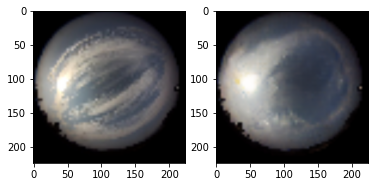

In [51]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[100,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[100,7][:,:,::-1])
f1 = feature_vector_gt_test[100,7]
f2 = feature_vector_pred_test[100,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.8285512971261312


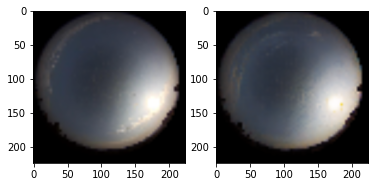

In [52]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[500,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[500,7][:,:,::-1])
f1 = feature_vector_gt_test[500,7]
f2 = feature_vector_pred_test[500,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.5979153702160013


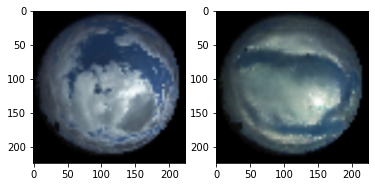

In [53]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[3445,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[3445,7][:,:,::-1])
f1 = feature_vector_gt_test[3445,7]
f2 = feature_vector_pred_test[3445,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

-------------------------------------------------- sample  1 --------------------------------------------------


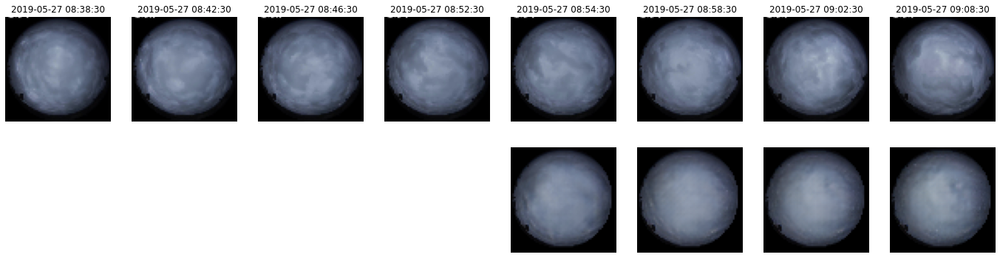

-------------------------------------------------- sample  2 --------------------------------------------------


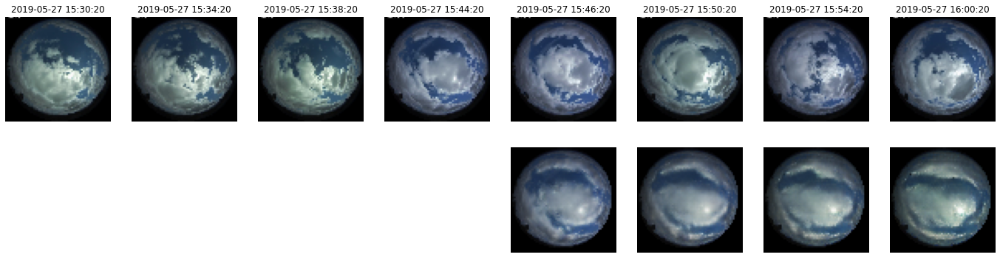

-------------------------------------------------- sample  3 --------------------------------------------------


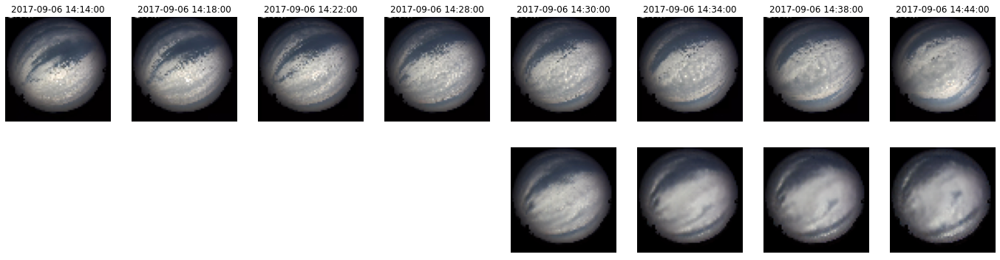

-------------------------------------------------- sample  4 --------------------------------------------------


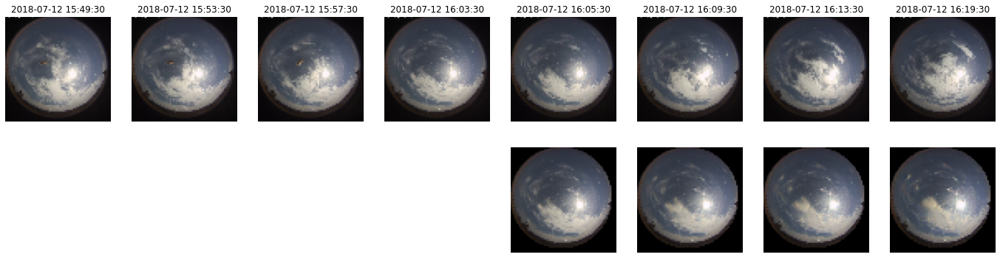

-------------------------------------------------- sample  5 --------------------------------------------------


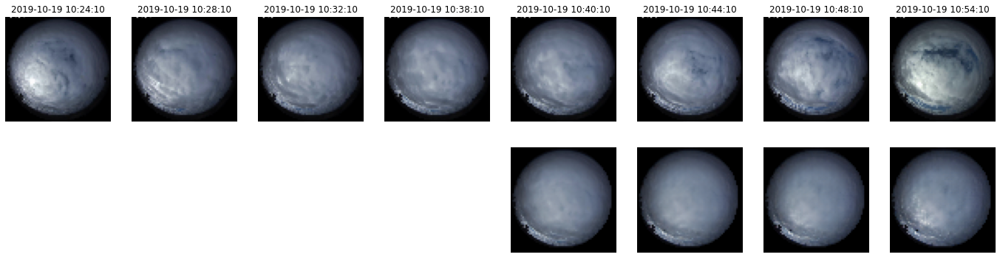

-------------------------------------------------- sample  6 --------------------------------------------------


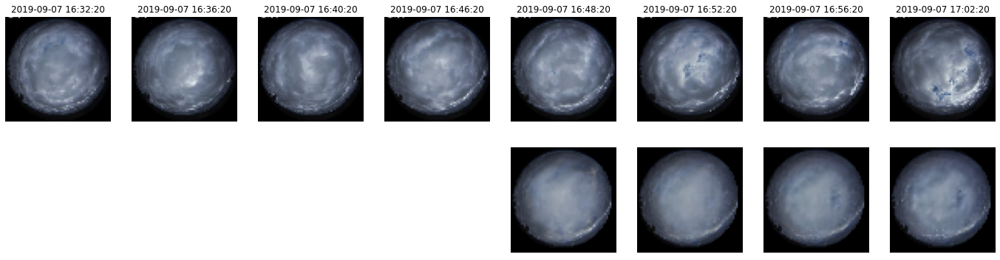

-------------------------------------------------- sample  7 --------------------------------------------------


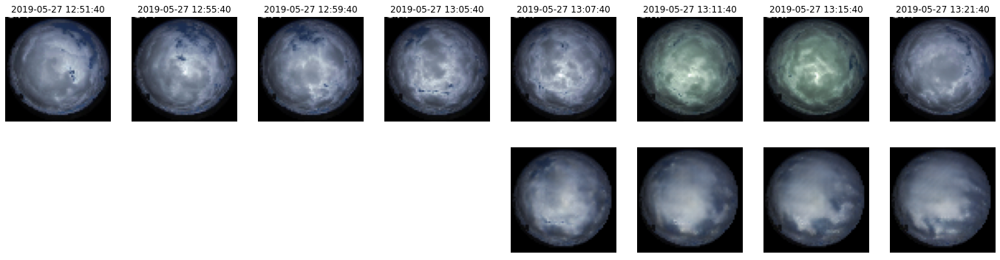

-------------------------------------------------- sample  8 --------------------------------------------------


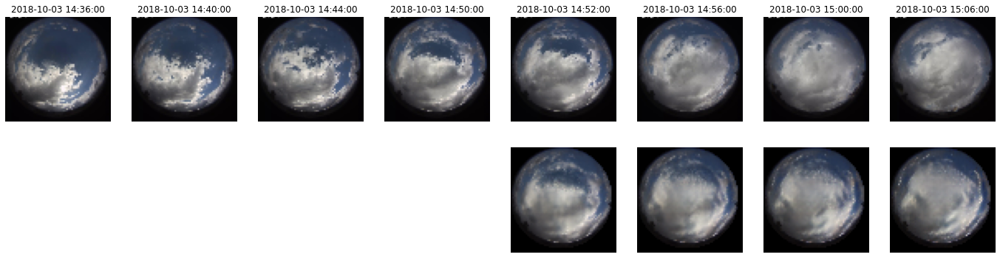

-------------------------------------------------- sample  9 --------------------------------------------------


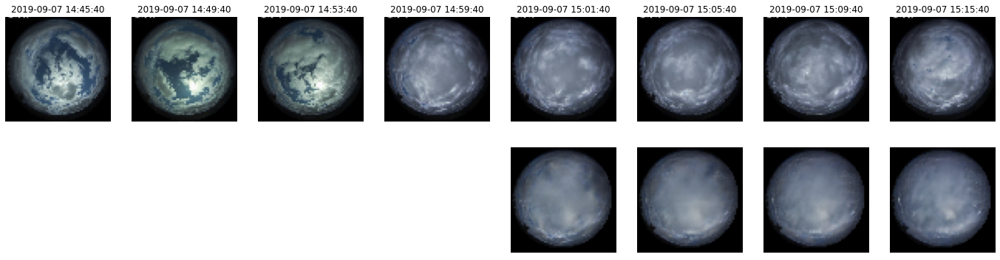

-------------------------------------------------- sample  10 --------------------------------------------------


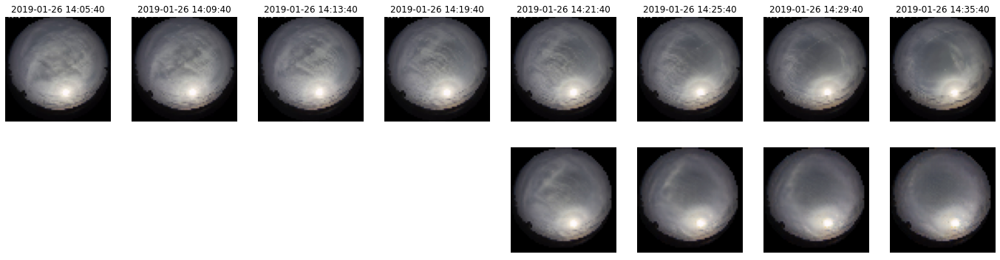

-------------------------------------------------- sample  11 --------------------------------------------------


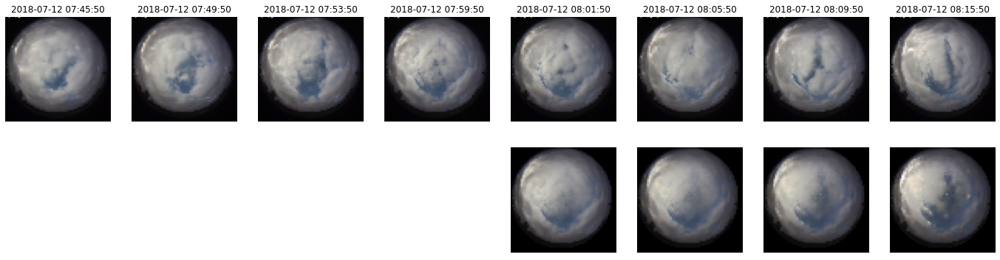

-------------------------------------------------- sample  12 --------------------------------------------------


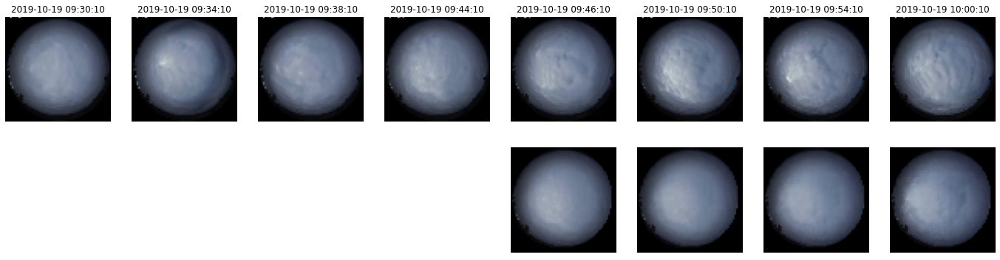

-------------------------------------------------- sample  13 --------------------------------------------------


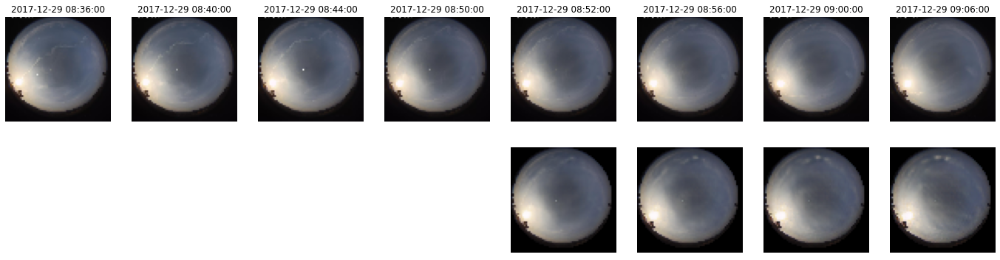

-------------------------------------------------- sample  14 --------------------------------------------------


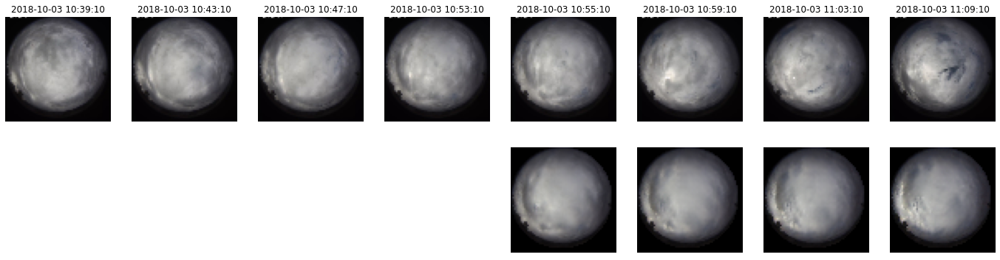

-------------------------------------------------- sample  15 --------------------------------------------------


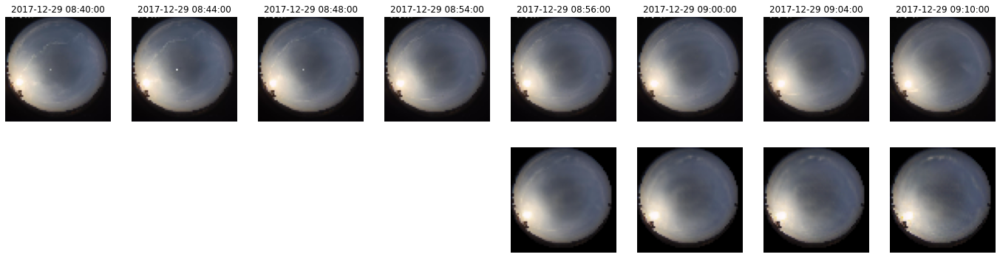

-------------------------------------------------- sample  16 --------------------------------------------------


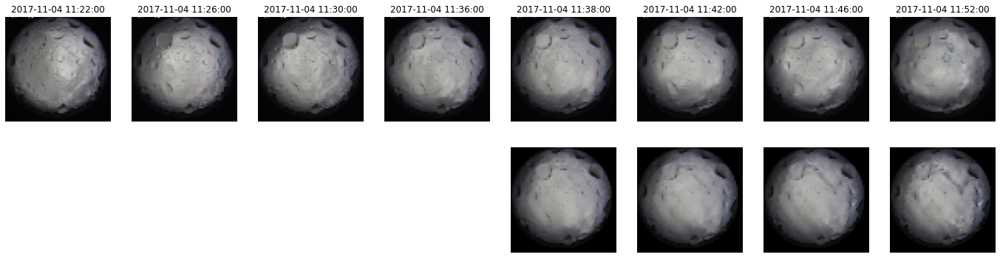

-------------------------------------------------- sample  17 --------------------------------------------------


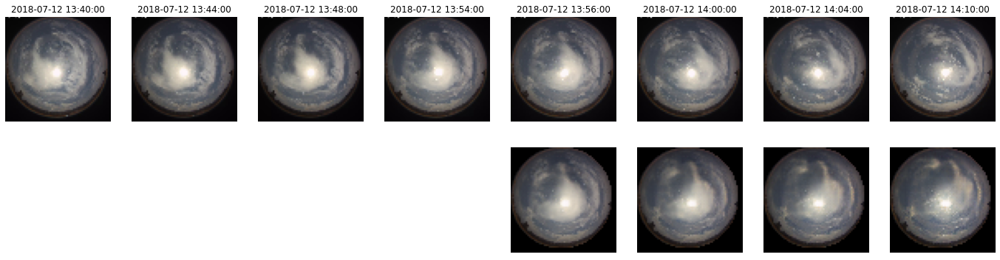

-------------------------------------------------- sample  18 --------------------------------------------------


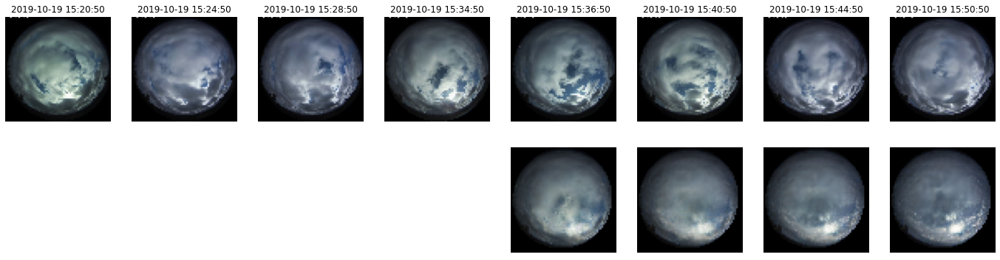

-------------------------------------------------- sample  19 --------------------------------------------------


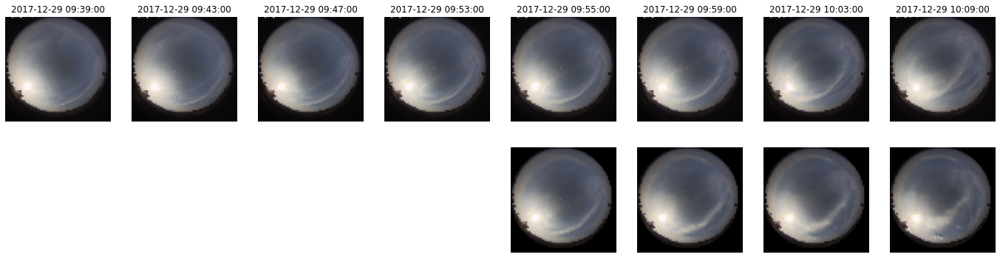

-------------------------------------------------- sample  20 --------------------------------------------------


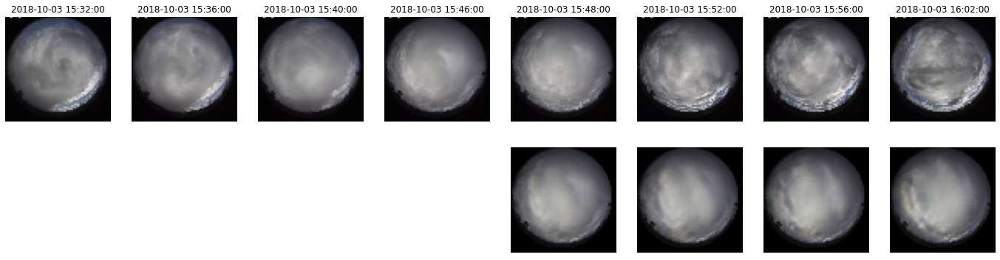

-------------------------------------------------- sample  21 --------------------------------------------------


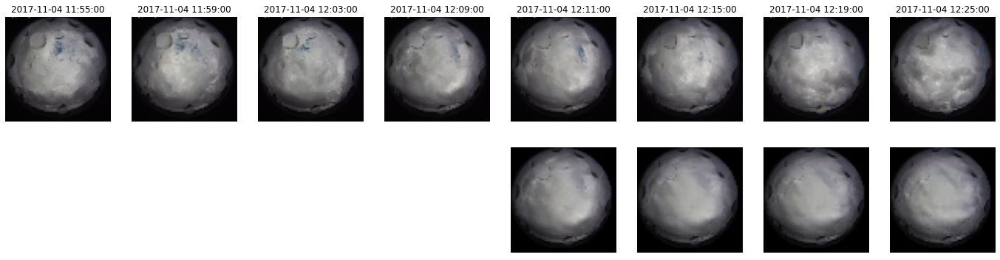

-------------------------------------------------- sample  22 --------------------------------------------------


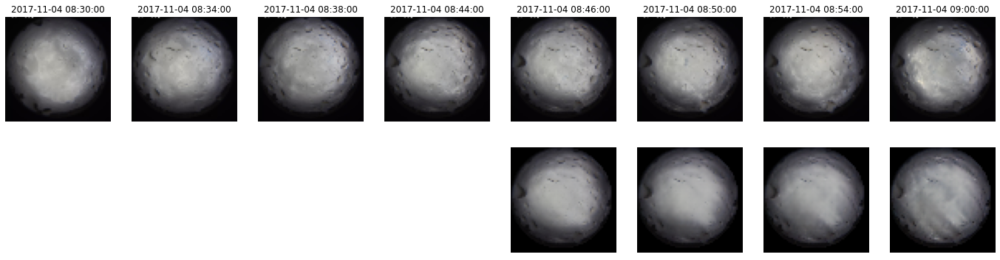

-------------------------------------------------- sample  23 --------------------------------------------------


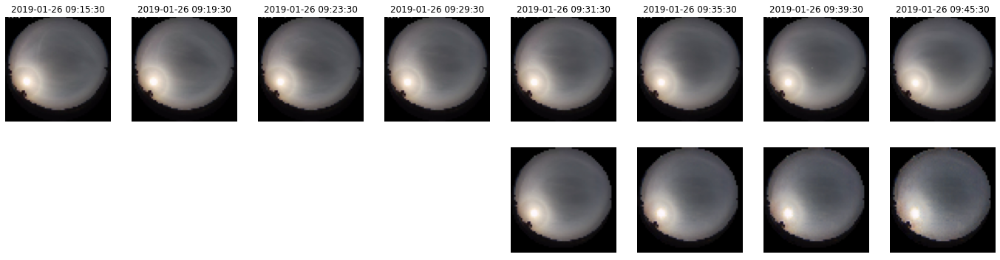

-------------------------------------------------- sample  24 --------------------------------------------------


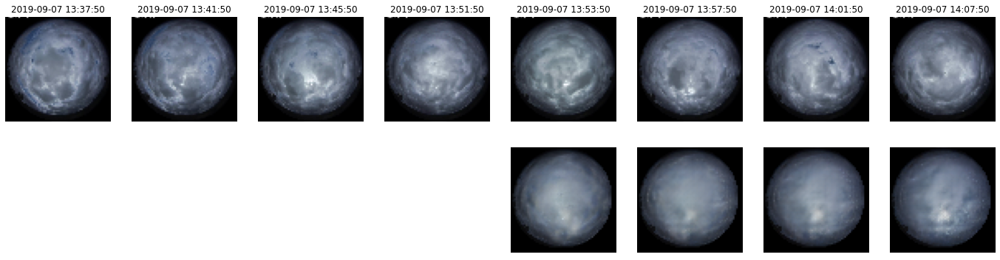

-------------------------------------------------- sample  25 --------------------------------------------------


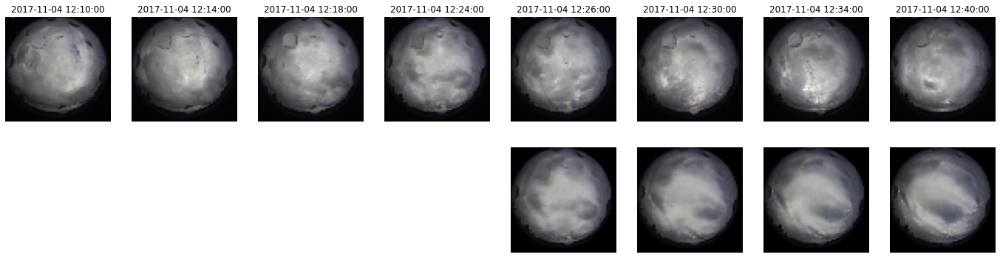

-------------------------------------------------- sample  26 --------------------------------------------------


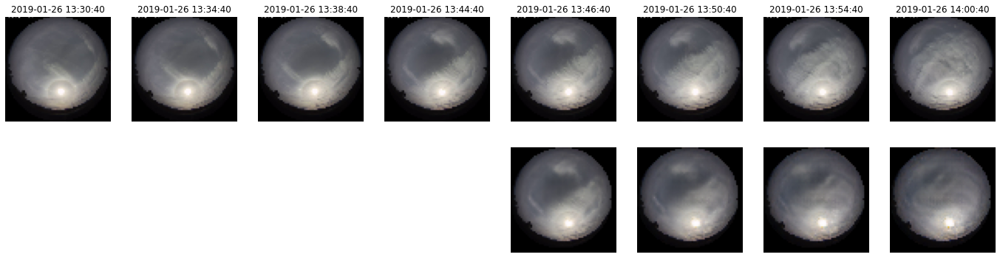

-------------------------------------------------- sample  27 --------------------------------------------------


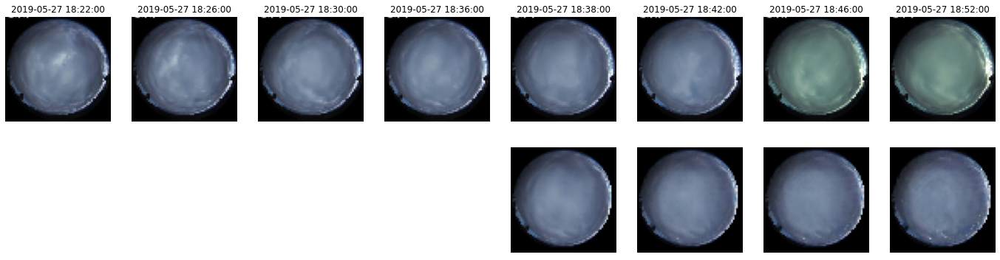

-------------------------------------------------- sample  28 --------------------------------------------------


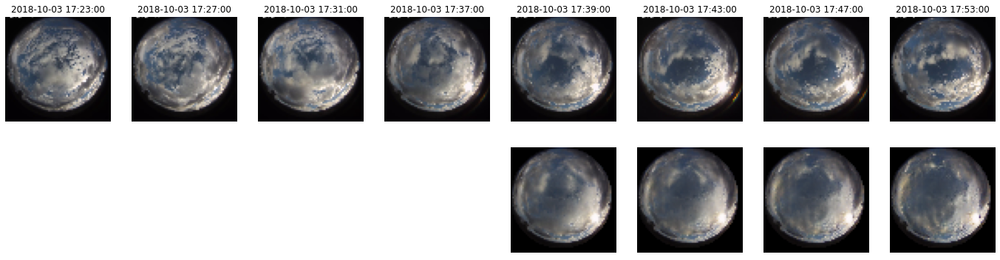

-------------------------------------------------- sample  29 --------------------------------------------------


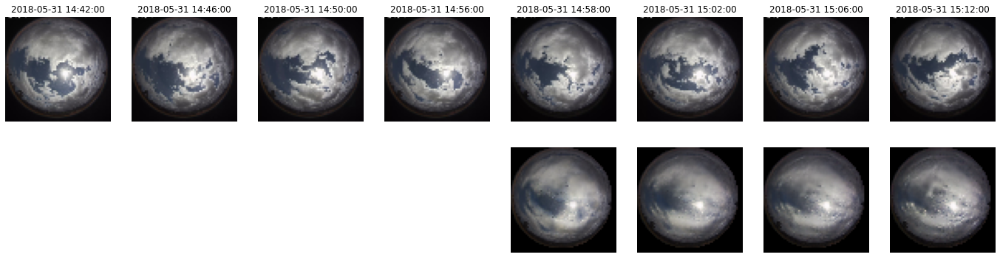

-------------------------------------------------- sample  30 --------------------------------------------------


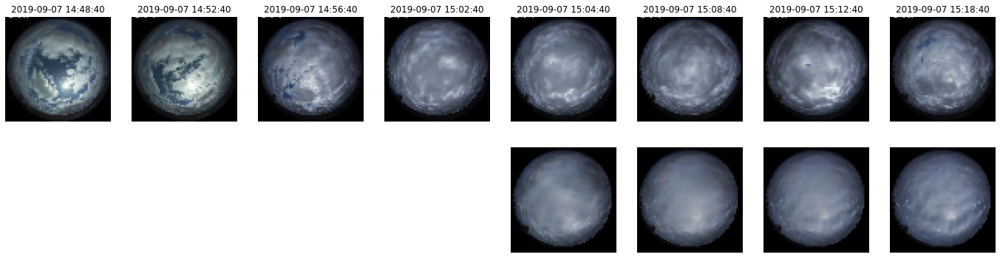

In [13]:
for i in range(select_num_samples):
    print("-"*50,"sample ",str(i+1), "-"*50)
    f, ax = plt.subplots(2,8)
    f.set_size_inches(24,6)
    ax[0,0].imshow(images_log_test[select_idx[i]][0][:,:,::-1])
    ax[0,0].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=15))
    ax[0,1].imshow(images_log_test[select_idx[i]][2][:,:,::-1])
    ax[0,1].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=11))
    ax[0,2].imshow(images_log_test[select_idx[i]][4][:,:,::-1])
    ax[0,2].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=7))
    ax[0,3].imshow(images_log_test[select_idx[i]][7][:,:,::-1])
    ax[0,3].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=1))
    ax[0,4].imshow(images_pred_test[select_idx[i]][0][:,:,::-1])
    ax[0,4].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=1))
    ax[0,5].imshow(images_pred_test[select_idx[i]][2][:,:,::-1])
    ax[0,5].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=5))
    ax[0,6].imshow(images_pred_test[select_idx[i]][4][:,:,::-1])
    ax[0,6].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=9))
    ax[0,7].imshow(images_pred_test[select_idx[i]][7][:,:,::-1])
    ax[0,7].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=15))
    
    ax[1,4].imshow(predicted_images[select_idx[i]][0][:,:,::-1])
    ax[1,5].imshow(predicted_images[select_idx[i]][2][:,:,::-1])
    ax[1,6].imshow(predicted_images[select_idx[i]][4][:,:,::-1])
    ax[1,7].imshow(predicted_images[select_idx[i]][7][:,:,::-1])
    
    ax[0,0].axis('off')
    ax[0,1].axis('off')
    ax[0,2].axis('off')
    ax[0,3].axis('off')
    ax[0,4].axis('off')
    ax[0,5].axis('off')
    ax[0,6].axis('off')
    ax[0,7].axis('off')
    ax[1,0].axis('off')
    ax[1,1].axis('off')
    ax[1,2].axis('off')
    ax[1,3].axis('off')
    ax[1,4].axis('off')
    ax[1,5].axis('off')
    ax[1,6].axis('off')
    ax[1,7].axis('off')
    
    plt.show()

In [54]:
mse_per_frame = np.mean(np.sum((predicted_images-mask_images_pred_test)**2,axis=(2,3,4)),axis=0)
mae_per_frame = np.mean(np.sum(np.abs(predicted_images-mask_images_pred_test),axis=(2,3,4)),axis=0)
ssim_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))
cosine_similarity_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))

for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        ssim_per_frame[i,j] = ssim(mask_images_pred_test[i,j], predicted_images[i,j], multichannel=True)
        
        # calcuate vgg cosine similarity
        cosine_similarity_per_frame[i,j] = calculate_cosine_similarity(feature_vector_gt_test[i,j],feature_vector_pred_test[i,j])

ssim_per_frame = np.mean(ssim_per_frame, axis=0)
cosine_similarity_per_frame = np.mean(cosine_similarity_per_frame, axis=0)

#np.save(os.path.join(output_folder,'SkyImageGAN_mse'),mse_per_frame)
#np.save(os.path.join(output_folder,'SkyImageGAN_mae'),mae_per_frame)
#np.save(os.path.join(output_folder,'SkyImageGAN_ssim'),ssim_per_frame)
np.save(os.path.join(output_folder,'SkyImageGAN_cosine_similarity_block4_pool'),cosine_similarity_per_frame)

for j in range(images_pred_test.shape[1]):
    print('-'*50)
    print('evaluation for {0} min'.format(j*2+1))
    print('mse (frame-wise): ', mse_per_frame[j])
    print('mae (frame-wise): ', mae_per_frame[j])
    print('ssim: ', ssim_per_frame[j])
    print('cosine_similarity: ', cosine_similarity_per_frame[j])
    
print("*"*50)
print('overall performance:')
print('mse (frame-wise): ', np.mean(mse_per_frame))
print('mae (frame-wise): ', np.mean(mae_per_frame))
print('ssim: ', np.mean(ssim_per_frame))
print('cosine_similarity: ', np.mean(cosine_similarity_per_frame))

--------------------------------------------------
evaluation for 1 min
mse (frame-wise):  25.94645
mae (frame-wise):  277.7851
ssim:  0.8892462694082659
cosine_similarity:  0.8327173830746561
--------------------------------------------------
evaluation for 3 min
mse (frame-wise):  38.21057
mae (frame-wise):  353.5151
ssim:  0.856674200600542
cosine_similarity:  0.7879176889078591
--------------------------------------------------
evaluation for 5 min
mse (frame-wise):  48.281895
mae (frame-wise):  407.20447
ssim:  0.8346598523491009
cosine_similarity:  0.7622542123509333
--------------------------------------------------
evaluation for 7 min
mse (frame-wise):  57.142982
mae (frame-wise):  449.39227
ssim:  0.818126224807581
cosine_similarity:  0.7437197473189335
--------------------------------------------------
evaluation for 9 min
mse (frame-wise):  64.91401
mae (frame-wise):  484.1623
ssim:  0.8045846867641165
cosine_similarity:  0.7286390276960456
---------------------------------

In [55]:
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))

0.80696702003479
0.7360318899154663
0.6942374110221863
0.6630595326423645
0.6408178210258484
0.6223713159561157
0.614686131477356
0.6085786819458008


#### PredRNNv1

In [56]:
# video prediction models for predicted images
vp_model = "PredRNN"
vp_model_name = 'cloud_predrnn'
vp_model_folder = os.path.join(pardir,"models",vp_model,"predrnn-pytorch","results", vp_model_name,'11674')

print("vp_model_folder:", vp_model_folder)

# load predicted images (only the last frame (t0+15))
predicted_images = np.load(os.path.join(vp_model_folder,"preds_11674.npz"))['preds']
predicted_images = mask_background(predicted_images.astype('float32'))
predicted_images = predicted_images/255
predicted_images_resized = np.zeros((predicted_images.shape[0],predicted_images.shape[1],224,224,3))
for i in range(predicted_images.shape[0]):
    for j in range(predicted_images.shape[1]):
        predicted_images_resized[i,j] = cv2.resize(predicted_images[i,j],(224,224))
feature_vector_pred_test = get_feature_vector3(predicted_images_resized*255)
print("predicted_images.shape:",predicted_images.shape)
print("feature_vector_pred_test.shape:",feature_vector_pred_test.shape)

vp_model_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/models/PredRNN/predrnn-pytorch/results/cloud_predrnn/11674
predicted_images.shape: (4467, 8, 64, 64, 3)
feature_vector_pred_test.shape: (4467, 8, 100352)


0.6236058964851625


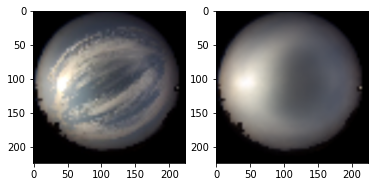

In [57]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[100,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[100,7][:,:,::-1])
f1 = feature_vector_gt_test[100,7]
f2 = feature_vector_pred_test[100,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.8486062241788641


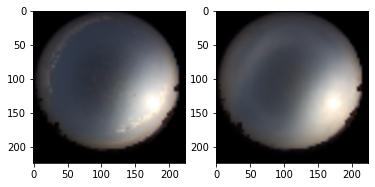

In [58]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[500,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[500,7][:,:,::-1])
f1 = feature_vector_gt_test[500,7]
f2 = feature_vector_pred_test[500,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.5671836391990566


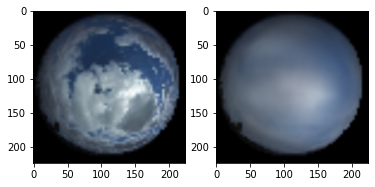

In [59]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[3445,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[3445,7][:,:,::-1])
f1 = feature_vector_gt_test[3445,7]
f2 = feature_vector_pred_test[3445,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.6069152962181155


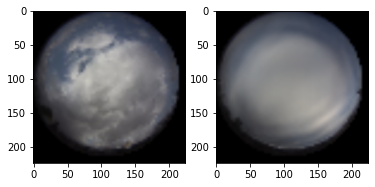

In [62]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[2484,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[2484,7][:,:,::-1])
f1 = feature_vector_gt_test[2484,7]
f2 = feature_vector_pred_test[2484,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

-------------------------------------------------- sample  1 --------------------------------------------------


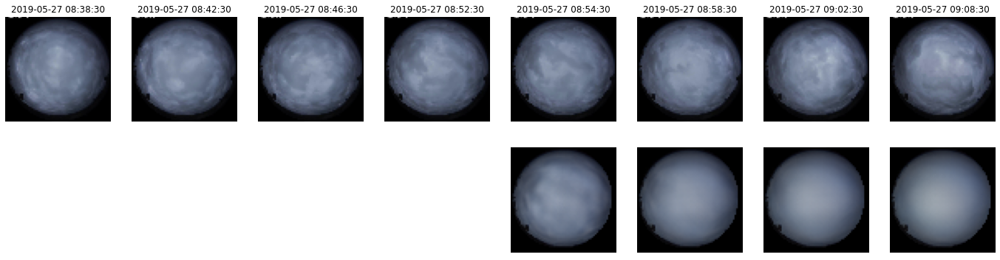

-------------------------------------------------- sample  2 --------------------------------------------------


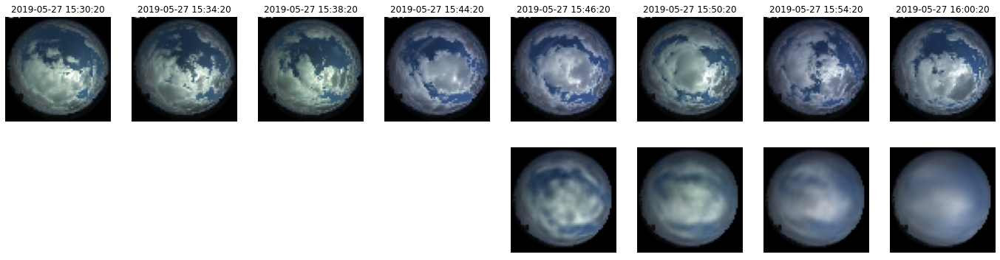

-------------------------------------------------- sample  3 --------------------------------------------------


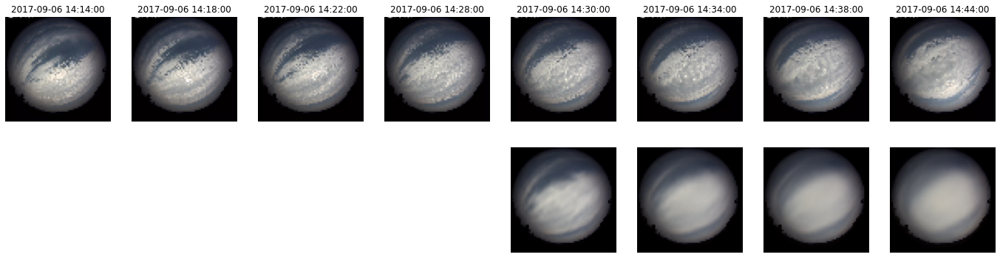

-------------------------------------------------- sample  4 --------------------------------------------------


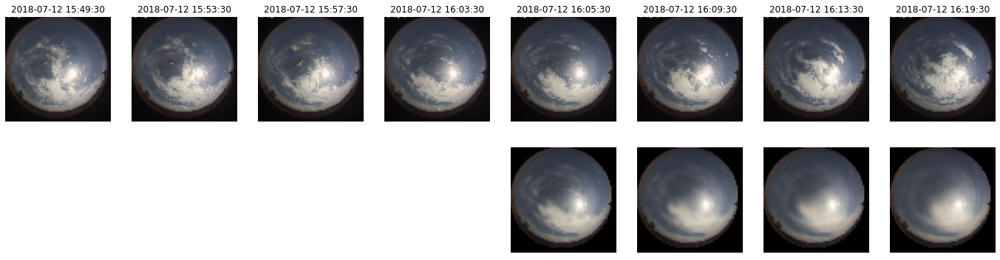

-------------------------------------------------- sample  5 --------------------------------------------------


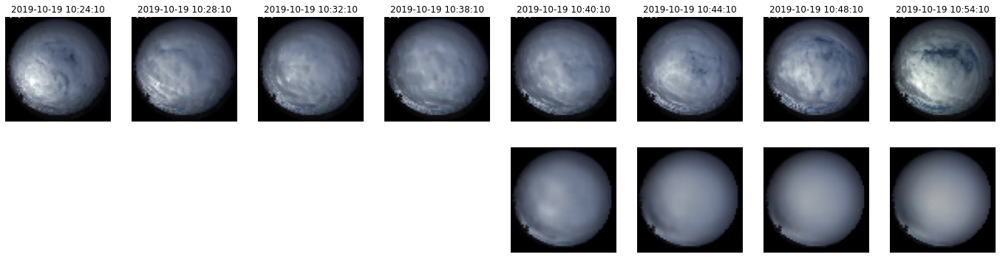

-------------------------------------------------- sample  6 --------------------------------------------------


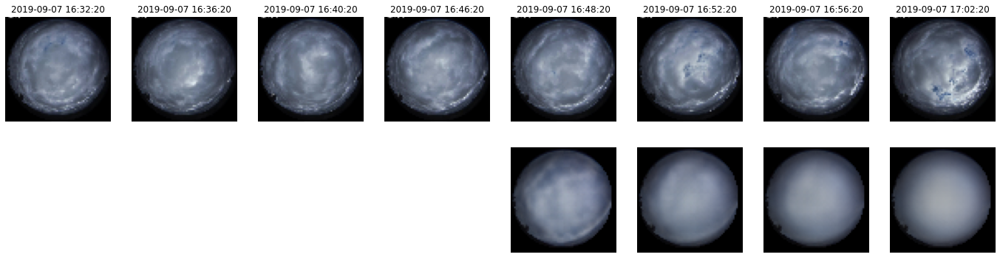

-------------------------------------------------- sample  7 --------------------------------------------------


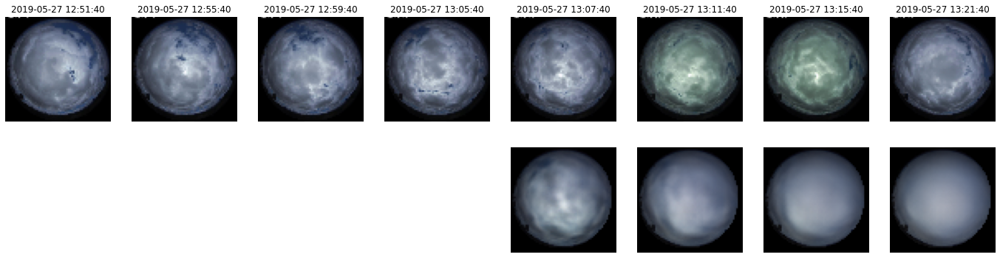

-------------------------------------------------- sample  8 --------------------------------------------------


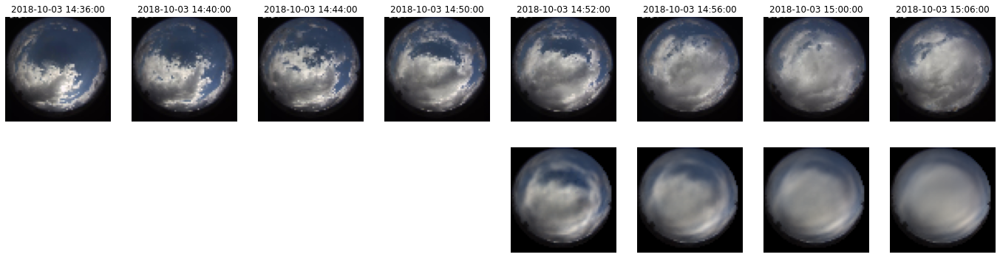

-------------------------------------------------- sample  9 --------------------------------------------------


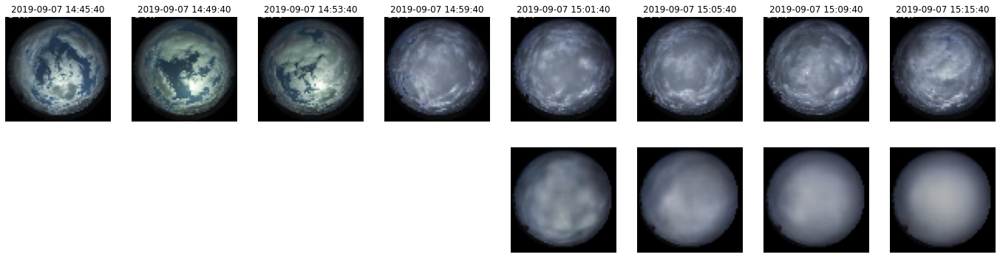

-------------------------------------------------- sample  10 --------------------------------------------------


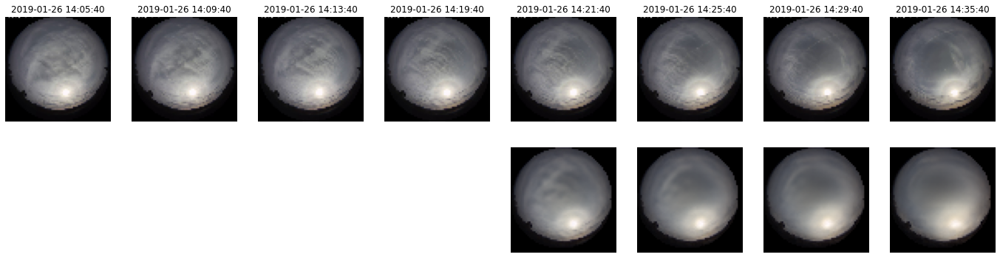

-------------------------------------------------- sample  11 --------------------------------------------------


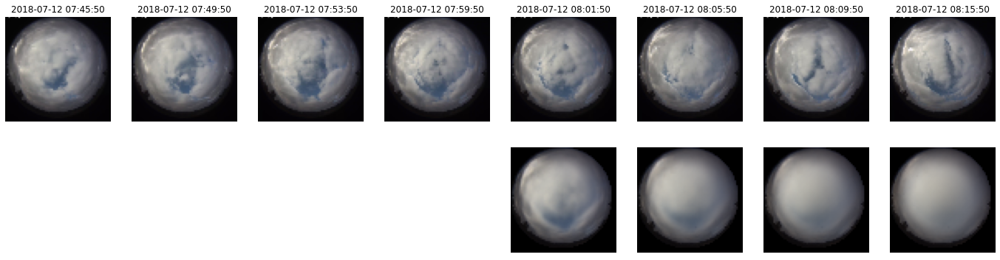

-------------------------------------------------- sample  12 --------------------------------------------------


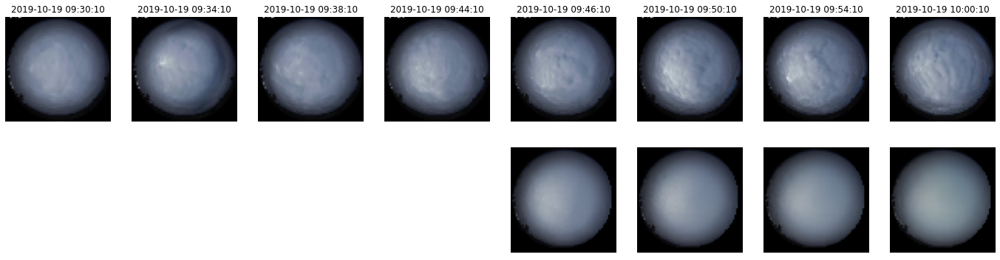

-------------------------------------------------- sample  13 --------------------------------------------------


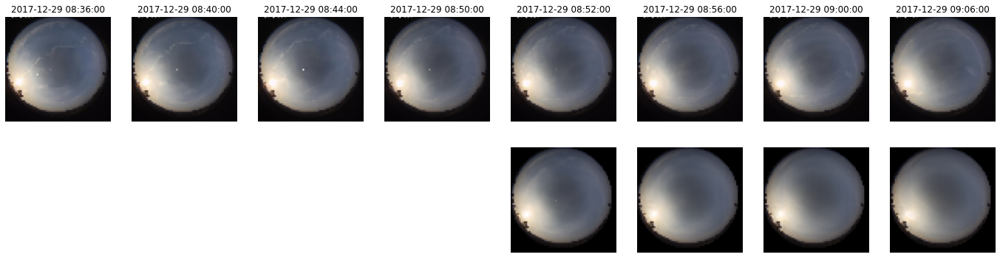

-------------------------------------------------- sample  14 --------------------------------------------------


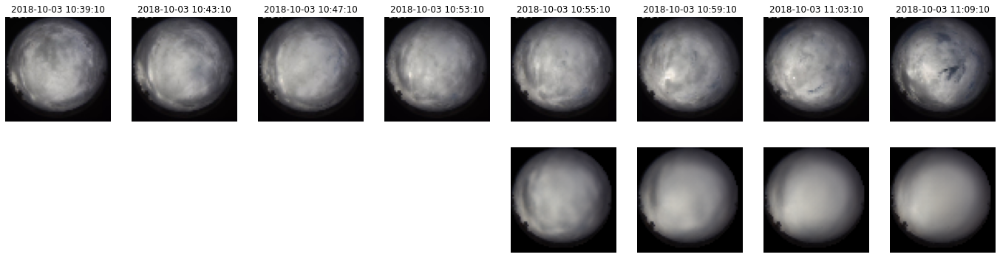

-------------------------------------------------- sample  15 --------------------------------------------------


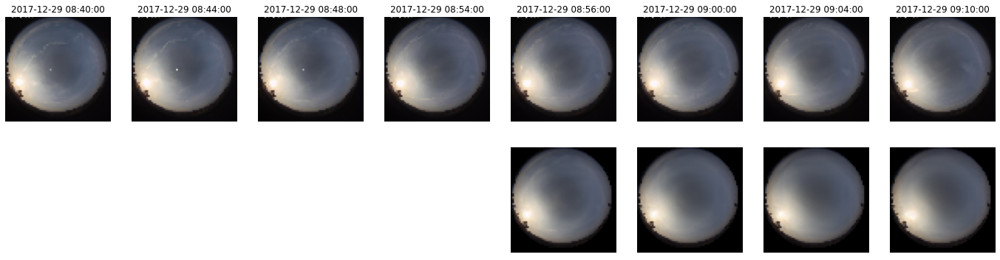

-------------------------------------------------- sample  16 --------------------------------------------------


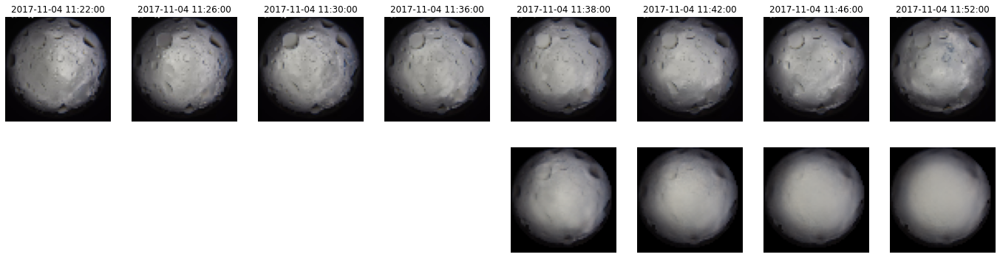

-------------------------------------------------- sample  17 --------------------------------------------------


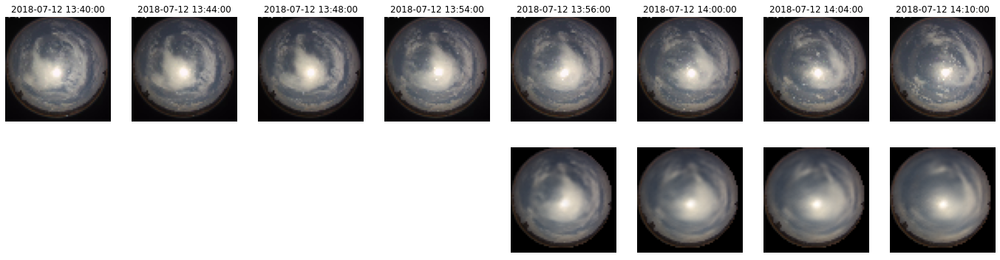

-------------------------------------------------- sample  18 --------------------------------------------------


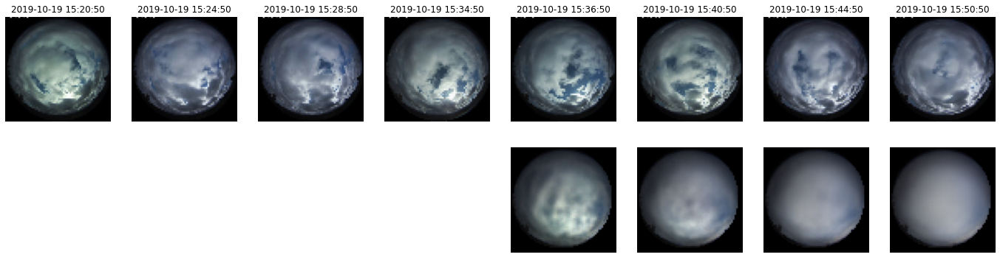

-------------------------------------------------- sample  19 --------------------------------------------------


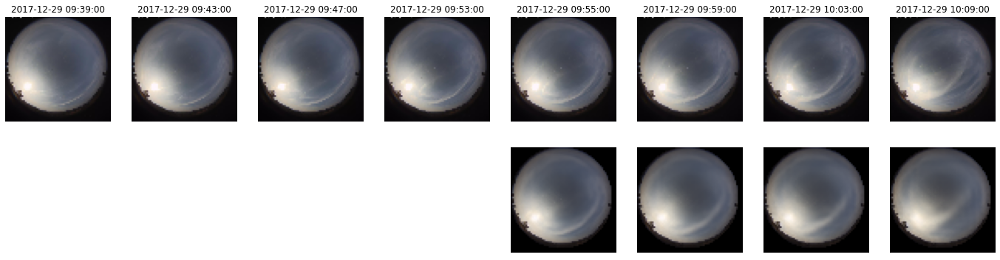

-------------------------------------------------- sample  20 --------------------------------------------------


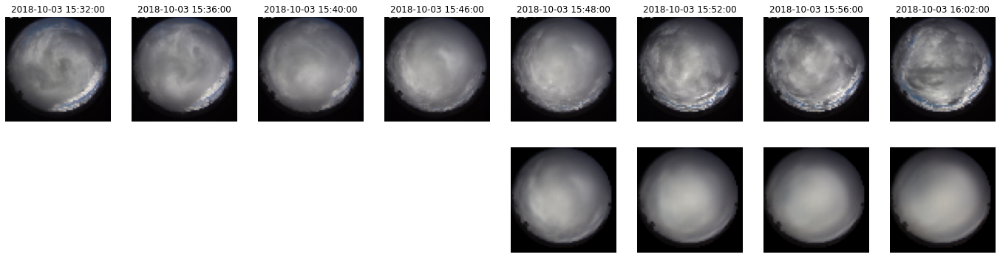

-------------------------------------------------- sample  21 --------------------------------------------------


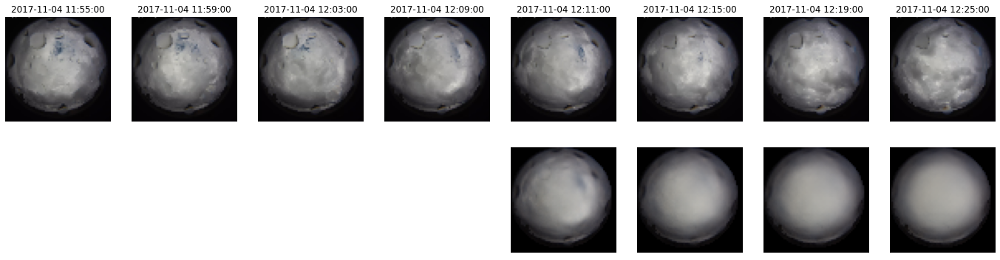

-------------------------------------------------- sample  22 --------------------------------------------------


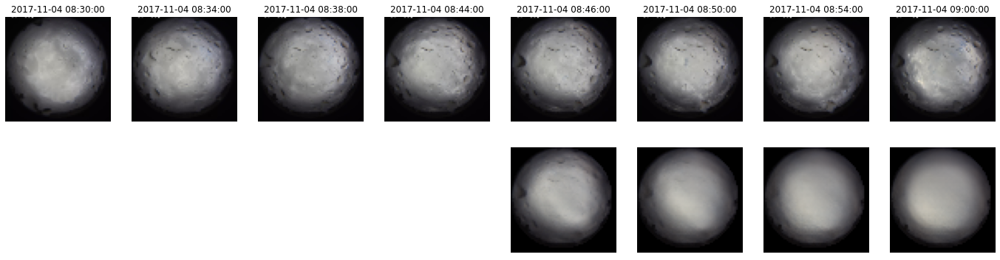

-------------------------------------------------- sample  23 --------------------------------------------------


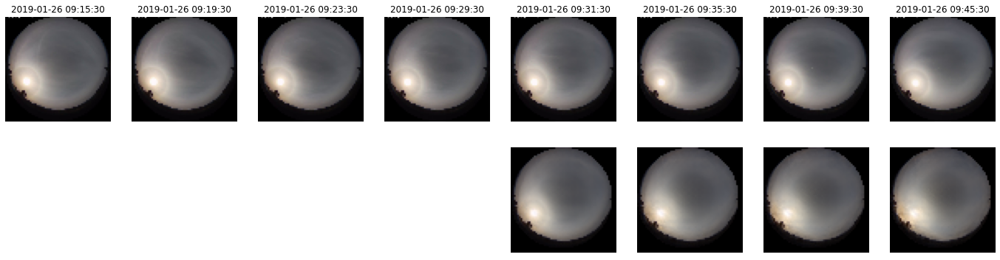

-------------------------------------------------- sample  24 --------------------------------------------------


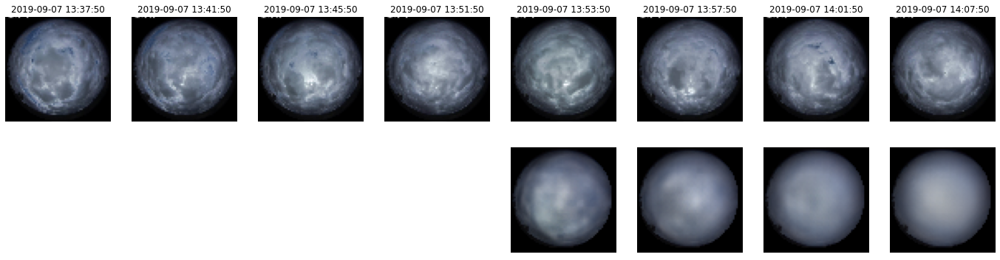

-------------------------------------------------- sample  25 --------------------------------------------------


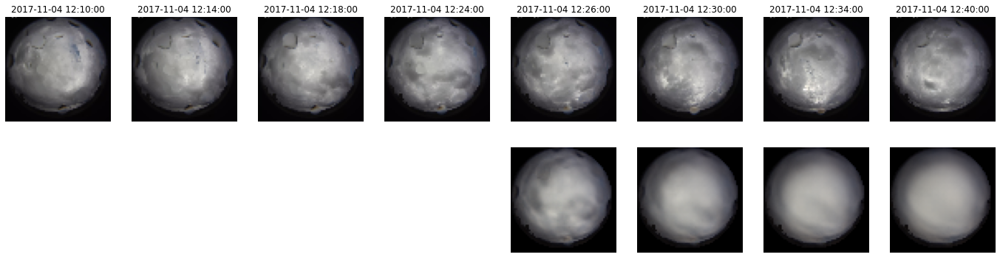

-------------------------------------------------- sample  26 --------------------------------------------------


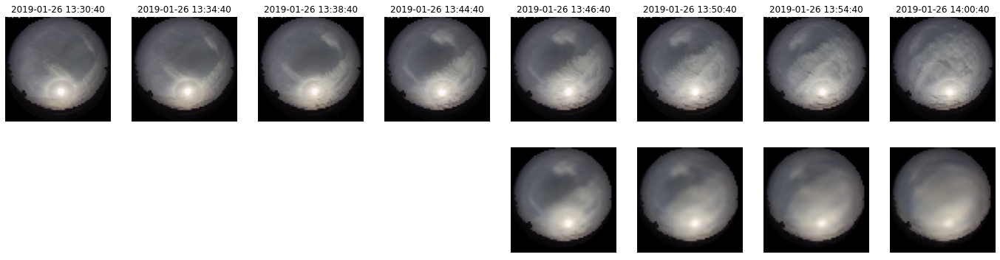

-------------------------------------------------- sample  27 --------------------------------------------------


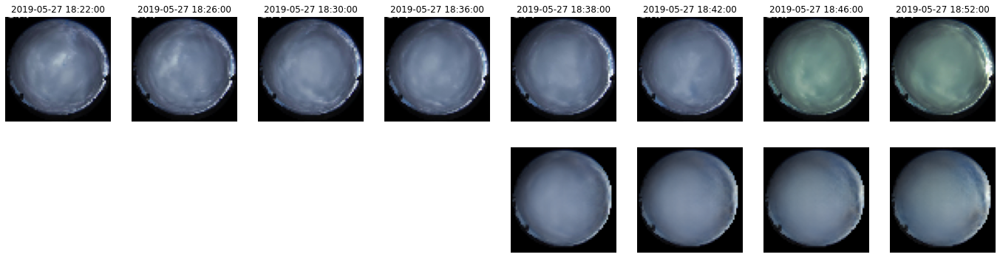

-------------------------------------------------- sample  28 --------------------------------------------------


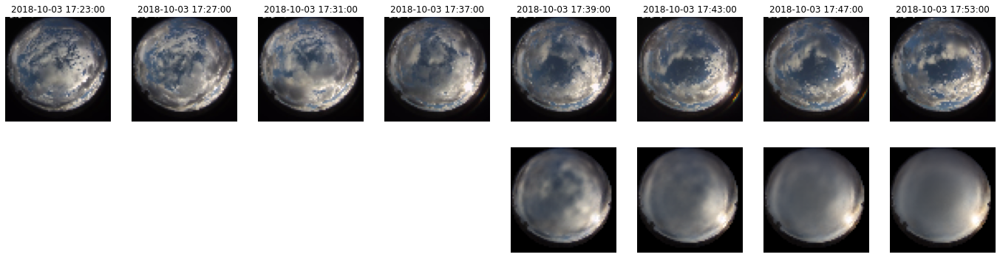

-------------------------------------------------- sample  29 --------------------------------------------------


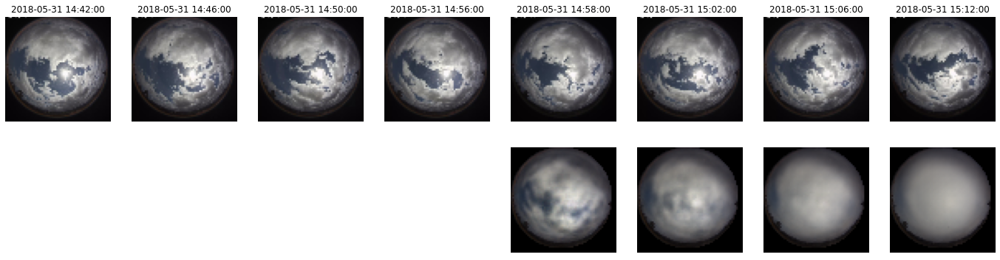

-------------------------------------------------- sample  30 --------------------------------------------------


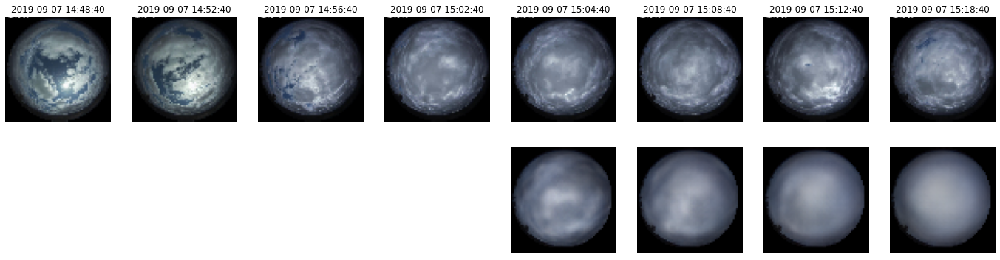

In [16]:
for i in range(select_num_samples):
    print("-"*50,"sample ",str(i+1), "-"*50)
    f, ax = plt.subplots(2,8)
    f.set_size_inches(24,6)
    ax[0,0].imshow(images_log_test[select_idx[i]][0][:,:,::-1])
    ax[0,0].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=15))
    ax[0,1].imshow(images_log_test[select_idx[i]][2][:,:,::-1])
    ax[0,1].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=11))
    ax[0,2].imshow(images_log_test[select_idx[i]][4][:,:,::-1])
    ax[0,2].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=7))
    ax[0,3].imshow(images_log_test[select_idx[i]][7][:,:,::-1])
    ax[0,3].set_title(times_test[select_idx[i]]-datetime.timedelta(minutes=1))
    ax[0,4].imshow(images_pred_test[select_idx[i]][0][:,:,::-1])
    ax[0,4].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=1))
    ax[0,5].imshow(images_pred_test[select_idx[i]][2][:,:,::-1])
    ax[0,5].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=5))
    ax[0,6].imshow(images_pred_test[select_idx[i]][4][:,:,::-1])
    ax[0,6].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=9))
    ax[0,7].imshow(images_pred_test[select_idx[i]][7][:,:,::-1])
    ax[0,7].set_title(times_test[select_idx[i]]+datetime.timedelta(minutes=15))
    
    ax[1,4].imshow(predicted_images[select_idx[i]][0][:,:,::-1])
    ax[1,5].imshow(predicted_images[select_idx[i]][2][:,:,::-1])
    ax[1,6].imshow(predicted_images[select_idx[i]][4][:,:,::-1])
    ax[1,7].imshow(predicted_images[select_idx[i]][7][:,:,::-1])
    
    ax[0,0].axis('off')
    ax[0,1].axis('off')
    ax[0,2].axis('off')
    ax[0,3].axis('off')
    ax[0,4].axis('off')
    ax[0,5].axis('off')
    ax[0,6].axis('off')
    ax[0,7].axis('off')
    ax[1,0].axis('off')
    ax[1,1].axis('off')
    ax[1,2].axis('off')
    ax[1,3].axis('off')
    ax[1,4].axis('off')
    ax[1,5].axis('off')
    ax[1,6].axis('off')
    ax[1,7].axis('off')
    
    plt.show()

In [60]:
mse_per_frame = np.mean(np.sum((predicted_images-mask_images_pred_test)**2,axis=(2,3,4)),axis=0)
mae_per_frame = np.mean(np.sum(np.abs(predicted_images-mask_images_pred_test),axis=(2,3,4)),axis=0)
ssim_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))
cosine_similarity_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))

for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        ssim_per_frame[i,j] = ssim(mask_images_pred_test[i,j], predicted_images[i,j], multichannel=True)
        
        # calcuate vgg cosine similarity
        cosine_similarity_per_frame[i,j] = calculate_cosine_similarity(feature_vector_gt_test[i,j],feature_vector_pred_test[i,j])

ssim_per_frame = np.mean(ssim_per_frame, axis=0)
cosine_similarity_per_frame = np.mean(cosine_similarity_per_frame, axis=0)

#np.save(os.path.join(output_folder,'PredRNNv1_mse'),mse_per_frame)
#np.save(os.path.join(output_folder,'PredRNNv1_mae'),mae_per_frame)
#np.save(os.path.join(output_folder,'PredRNNv1_ssim'),ssim_per_frame)
np.save(os.path.join(output_folder,'PredRNNv1_cosine_similarity_block4_pool'),cosine_similarity_per_frame)

for j in range(images_pred_test.shape[1]):
    print('-'*50)
    print('evaluation for {0} min'.format(j*2+1))
    print('mse (frame-wise): ', mse_per_frame[j])
    print('mae (frame-wise): ', mae_per_frame[j])
    print('ssim: ', ssim_per_frame[j])
    print('cosine_similarity: ', cosine_similarity_per_frame[j])
    
print("*"*50)
print('overall performance:')
print('mse (frame-wise): ', np.mean(mse_per_frame))
print('mae (frame-wise): ', np.mean(mae_per_frame))
print('ssim: ', np.mean(ssim_per_frame))
print('cosine_similarity: ', np.mean(cosine_similarity_per_frame))

--------------------------------------------------
evaluation for 1 min
mse (frame-wise):  23.385391
mae (frame-wise):  265.47644
ssim:  0.899582821943153
cosine_similarity:  0.7977607216853858
--------------------------------------------------
evaluation for 3 min
mse (frame-wise):  34.636482
mae (frame-wise):  337.01974
ssim:  0.8684668205415279
cosine_similarity:  0.7520225037717415
--------------------------------------------------
evaluation for 5 min
mse (frame-wise):  42.161095
mae (frame-wise):  383.33072
ssim:  0.8523312736120185
cosine_similarity:  0.7267864105403435
--------------------------------------------------
evaluation for 7 min
mse (frame-wise):  48.19142
mae (frame-wise):  418.9407
ssim:  0.8422528658083577
cosine_similarity:  0.7101085370395345
--------------------------------------------------
evaluation for 9 min
mse (frame-wise):  53.68158
mae (frame-wise):  449.4192
ssim:  0.8343935028007713
cosine_similarity:  0.6974601098558095
------------------------------

In [61]:
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))

0.7625484466552734
0.6951607465744019
0.6770898103713989
0.6726758480072021
0.6667608618736267
0.6224400401115417
0.6208387613296509
0.6069170236587524


#### PredRNNv2

In [63]:
# video prediction models for predicted images
vp_model = "PredRNN"
vp_model_name = 'cloud_predrnn_v2'
vp_model_folder = os.path.join(pardir,"models",vp_model,"predrnn-pytorch","results", vp_model_name,'17512')

print("vp_model_folder:", vp_model_folder)

# load predicted images (only the last frame (t0+15))
predicted_images = np.load(os.path.join(vp_model_folder,"preds_17512.npz"))['preds']
predicted_images = mask_background(predicted_images.astype('float32'))
predicted_images = predicted_images/255
predicted_images_resized = np.zeros((predicted_images.shape[0],predicted_images.shape[1],224,224,3))
for i in range(predicted_images.shape[0]):
    for j in range(predicted_images.shape[1]):
        predicted_images_resized[i,j] = cv2.resize(predicted_images[i,j],(224,224))
feature_vector_pred_test = get_feature_vector3(predicted_images_resized*255)
print("predicted_images.shape:",predicted_images.shape)
print("feature_vector_pred_test.shape:",feature_vector_pred_test.shape)

vp_model_folder: /scratch/groups/abrandt/solar_forecasting/GAN_project_new/models/PredRNN/predrnn-pytorch/results/cloud_predrnn_v2/17512
predicted_images.shape: (4467, 8, 64, 64, 3)
feature_vector_pred_test.shape: (4467, 8, 100352)


0.6190377338037486


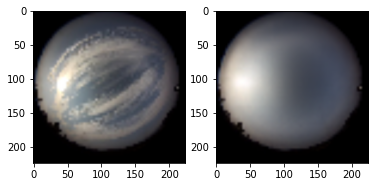

In [64]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[100,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[100,7][:,:,::-1])
f1 = feature_vector_gt_test[100,7]
f2 = feature_vector_pred_test[100,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.8273520688079982


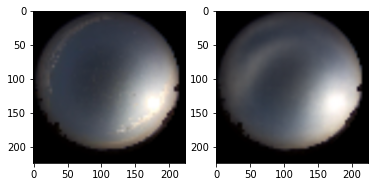

In [65]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[500,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[500,7][:,:,::-1])
f1 = feature_vector_gt_test[500,7]
f2 = feature_vector_pred_test[500,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.564763534883941


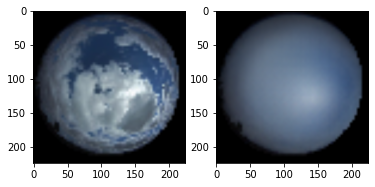

In [66]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[3445,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[3445,7][:,:,::-1])
f1 = feature_vector_gt_test[3445,7]
f2 = feature_vector_pred_test[3445,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

0.6143736140084695


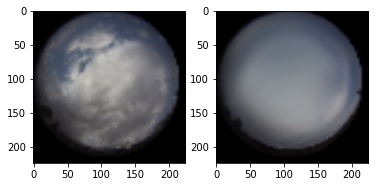

In [69]:
f,ax=plt.subplots(1,2)
ax[0].imshow(mask_images_pred_test_resized[2484,7][:,:,::-1])
ax[1].imshow(predicted_images_resized[2484,7][:,:,::-1])
f1 = feature_vector_gt_test[2484,7]
f2 = feature_vector_pred_test[2484,7]
print(calculate_cosine_similarity(f1,f2))
plt.show()

In [67]:
mse_per_frame = np.mean(np.sum((predicted_images-mask_images_pred_test)**2,axis=(2,3,4)),axis=0)
mae_per_frame = np.mean(np.sum(np.abs(predicted_images-mask_images_pred_test),axis=(2,3,4)),axis=0)
ssim_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))
cosine_similarity_per_frame = np.zeros((images_pred_test.shape[0],mask_images_pred_test.shape[1]))

for i in range(images_pred_test.shape[0]):
    for j in range(images_pred_test.shape[1]):
        ssim_per_frame[i,j] = ssim(mask_images_pred_test[i,j], predicted_images[i,j], multichannel=True)
        
        # calcuate vgg cosine similarity
        cosine_similarity_per_frame[i,j] = calculate_cosine_similarity(feature_vector_gt_test[i,j],feature_vector_pred_test[i,j])

ssim_per_frame = np.mean(ssim_per_frame, axis=0)
cosine_similarity_per_frame = np.mean(cosine_similarity_per_frame, axis=0)

#np.save(os.path.join(output_folder,'PredRNNv2_mse'),mse_per_frame)
#np.save(os.path.join(output_folder,'PredRNNv2_mae'),mae_per_frame)
#np.save(os.path.join(output_folder,'PredRNNv2_ssim'),ssim_per_frame)
np.save(os.path.join(output_folder,'PredRNNv2_cosine_similarity_block4_pool'),cosine_similarity_per_frame)

for j in range(images_pred_test.shape[1]):
    print('-'*50)
    print('evaluation for {0} min'.format(j*2+1))
    print('mse (frame-wise): ', mse_per_frame[j])
    print('mae (frame-wise): ', mae_per_frame[j])
    print('ssim: ', ssim_per_frame[j])
    print('cosine_similarity: ', cosine_similarity_per_frame[j])
    
print("*"*50)
print('overall performance:')
print('mse (frame-wise): ', np.mean(mse_per_frame))
print('mae (frame-wise): ', np.mean(mae_per_frame))
print('ssim: ', np.mean(ssim_per_frame))
print('cosine_similarity: ', np.mean(cosine_similarity_per_frame))

--------------------------------------------------
evaluation for 1 min
mse (frame-wise):  23.420177
mae (frame-wise):  279.4773
ssim:  0.8908995765456256
cosine_similarity:  0.7603064371673758
--------------------------------------------------
evaluation for 3 min
mse (frame-wise):  32.95152
mae (frame-wise):  341.67575
ssim:  0.8659308897173092
cosine_similarity:  0.7219822532390897
--------------------------------------------------
evaluation for 5 min
mse (frame-wise):  40.122643
mae (frame-wise):  385.12415
ssim:  0.8514855318448961
cosine_similarity:  0.7024854036864887
--------------------------------------------------
evaluation for 7 min
mse (frame-wise):  46.27842
mae (frame-wise):  419.9893
ssim:  0.8411513833592189
cosine_similarity:  0.690207461614126
--------------------------------------------------
evaluation for 9 min
mse (frame-wise):  51.912178
mae (frame-wise):  450.09225
ssim:  0.8326202138172474
cosine_similarity:  0.6815211289933208
------------------------------

In [68]:
for i in range(8):
    f1 = (get_feature_vector(mask_images_pred_test[2484,i]*255))
    f2 = (get_feature_vector(predicted_images[2484,i]*255))
    print(calculate_cosine_similarity(f1,f2))

0.7010916471481323
0.6580020189285278
0.6361770629882812
0.6384625434875488
0.6343198418617249
0.6052840948104858
0.6069535613059998
0.6143744587898254
